# End to End Multiclass Mushroom Species Classification (GitHub)
This Notebook builds an end to end multiclass image classifier using TensorFlow and TensorFlow Hub.

## Problem
Identifying the species of mushrooms given an image of a mushroom.

When I come across a wild mushroom, I typically take a picture of it so that I can determine what species it is. 

## Data
The data we're utilizing is available on Kaggle.
Available at the following urls:
https://www.kaggle.com/datasets/harperd17/mushroom-pictures

https://www.kaggle.com/datasets/derekkunowilliams/mushrooms

## Features
Some information about the data:
The dataset consists of numerous images (unstructured data).
There are approximately 2800+ images in the dataset. We expect to use .1 for validation.

This data set consists of 6 different species ( this means there are 6 different classes) with quantities specified.

Amanita bisporigera - 606

Amanita muscaria - 367

Boletus edulis - 444

Cantharellus - 1183

Omphalotus olearius - 59

Russula mariae - 235

2894 -1 = 2893 photos in first data set.

A part of a second dataset was merged with the first set:

48 photos of Amanita Bisporigera

51 photos of Amanita Muscaria

64 BOletus Edulis

50 Cantharellus

33 Omphalotus orealius

246 images from second dataset

3139 total images

Omphalotus Orealius was omitted due to low number of images.

### **Total Number of Images = 3047**

#Necessary Imports and Data Retrieval


In [1]:
pip install gradio

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 5.1 MB 5.8 MB/s 
     |████████████████████████████████| 140 kB 49.4 MB/s 
     |████████████████████████████████| 272 kB 52.9 MB/s 
     |████████████████████████████████| 54 kB 2.8 MB/s 
     |████████████████████████████████| 84 kB 2.7 MB/s 
     |████████████████████████████████| 2.3 MB 37.8 MB/s 
     |████████████████████████████████| 1.1 MB 45.4 MB/s 
     |████████████████████████████████| 84 kB 1.5 MB/s 
     |████████████████████████████████| 57 kB 5.1 MB/s 
     |████████████████████████████████| 212 kB 60.3 MB/s 
     |████████████████████████████████| 144 kB 51.9 MB/s 
     |████████████████████████████████| 94 kB 2.6 MB/s 
     |████████████████████████████████| 271 kB 51.2 MB/s 
     |████████████████████████████████| 63 kB 1.8 MB/s 
     |████████████████████████████████| 80 kB 8.7 MB/s 
     |████████████████████████████████| 68 kB 

pip install -r requirements.txt

## Retrieving files from GitHub

In [2]:
!git clone https://github.com/Jugarcia15/Project_Backup.git

Cloning into 'Project_Backup'...
remote: Enumerating objects: 49, done.
remote: Counting objects: 100% (11/11), done.
remote: Compressing objects: 100% (9/9), done.
remote: Total 49 (delta 3), reused 9 (delta 2), pack-reused 38
Unpacking objects: 100% (49/49), done.


In [3]:
# !wget https://github.com/Jugarcia15/Project_Backup/raw/main/basedata3.zip

In [4]:
!unzip "/content/Project_Backup/basedata3.zip" 

Archive:  /content/Project_Backup/basedata3.zip
   creating: basedata3/Amanita bisporigera/
  inflating: basedata3/Amanita bisporigera/100598.jpg  
  inflating: basedata3/Amanita bisporigera/100599.jpg  
  inflating: basedata3/Amanita bisporigera/100600.jpg  
  inflating: basedata3/Amanita bisporigera/100626.jpg  
  inflating: basedata3/Amanita bisporigera/100628.jpg  
  inflating: basedata3/Amanita bisporigera/100629.jpg  
  inflating: basedata3/Amanita bisporigera/100630.jpg  
  inflating: basedata3/Amanita bisporigera/100631.jpg  
  inflating: basedata3/Amanita bisporigera/101388.jpg  
  inflating: basedata3/Amanita bisporigera/101389.jpg  
  inflating: basedata3/Amanita bisporigera/101528.jpg  
  inflating: basedata3/Amanita bisporigera/101529.jpg  
  inflating: basedata3/Amanita bisporigera/101751.jpg  
  inflating: basedata3/Amanita bisporigera/101752.jpg  
  inflating: basedata3/Amanita bisporigera/101753.jpg  
  inflating: basedata3/Amanita bisporigera/101754.jpg  
  inflating:

In [5]:
!unzip "/content/Project_Backup/logs.zip"

Archive:  /content/Project_Backup/logs.zip
   creating: logs/EFN_Full_Model/
   creating: logs/EFN_Full_Model/train/
  inflating: logs/EFN_Full_Model/train/events.out.tfevents.1657008682.DESKTOP-JUAN.18904.2.v2  
   creating: logs/EFN_Partial_model/
   creating: logs/EFN_Partial_model/train/
  inflating: logs/EFN_Partial_model/train/events.out.tfevents.1657008447.DESKTOP-JUAN.18904.0.v2  
   creating: logs/EFN_Partial_model/validation/
  inflating: logs/EFN_Partial_model/validation/events.out.tfevents.1657008466.DESKTOP-JUAN.18904.1.v2  
   creating: logs/IV3_Full_model/
   creating: logs/IV3_Full_model/train/
  inflating: logs/IV3_Full_model/train/events.out.tfevents.1657006733.DESKTOP-JUAN.21724.2.v2  
   creating: logs/IV3_Partial_model/
   creating: logs/IV3_Partial_model/train/
  inflating: logs/IV3_Partial_model/train/events.out.tfevents.1657006251.DESKTOP-JUAN.21724.0.v2  
   creating: logs/IV3_Partial_model/validation/
  inflating: logs/IV3_Partial_model/validation/events.out.t

In [6]:
!unzip "/content/Project_Backup/test.zip"

Archive:  /content/Project_Backup/test.zip
  inflating: test/3rm.jpg            
  inflating: test/ab.jpg             
  inflating: test/ab1.jpg            
  inflating: test/ab2.jpg            
  inflating: test/ab3.jpg            
  inflating: test/ab4.jpg            
  inflating: test/am (1).jpeg        
  inflating: test/am (1).jpg         
  inflating: test/am (2).jpg         
  inflating: test/am (3).jpg         
  inflating: test/am (4).jpg         
  inflating: test/am (5).jpg         
  inflating: test/am45.jpg           
  inflating: test/am7.jpg            
  inflating: test/amanita_bisporigera_01.jpg  
  inflating: test/be (1).jpg         
  inflating: test/be (2).jpg         
  inflating: test/be (3).jpg         
  inflating: test/be (4).jpg         
  inflating: test/be (5).jpg         
  inflating: test/boletus-edulis7.jpg  
  inflating: test/ca2.jpg            
  inflating: test/ca3.jpg            
  inflating: test/ca4.jpg            
  inflating: test/ca5.jpg         

## Importing necessary libraries

In [13]:
from tensorflow.keras.layers import Input, Lambda, Dense, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.applications.inception_v3 import preprocess_input
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img
from tensorflow.keras.models import Sequential
import numpy as np
from glob import glob
import datetime,os
import gradio as gr
import pandas as pd
import ipywidgets as widgets
from ipywidgets import interact, interact_manual
from IPython.display import Image

### Importing Tensorflow

In [8]:
import tensorflow as tf
import tensorflow_hub as hub
tf.__version__

'2.8.2'

### Defining Save and Load Model functions


In [9]:
def save_model(model, suffix=None):
  modeldir = os.path.join("/content/",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path=modeldir+"-" + suffix + ".h5"
  print(f"Saving model to: {model_path}")
  model.save(model_path)
  return model_path

#create a function to save a model
#from tensorflow.keras.models import load_model
#model.save('1010_images_model_inceptionv3.h5')
def load_model(model_path):
  print(f"loading model from: {model_path}")
  model=tf.keras.models.load_model(model_path,
                                   custom_objects={"KerasLayer":hub.KerasLayer})
  return model

#Gradio Program


In [10]:
gradio_path = '/content/Project_Backup/MN_Full_model.h5'
gradio_model = load_model(gradio_path)

loading model from: /content/Project_Backup/MN_Full_model.h5


In [14]:
class_names=['Amanita Bisporigera',
                 'Amanita Muscaria',
                 'Boletus Edulis',
                 'Cantharellus',
                 'Russula Mariae'
                 ]
def predict_image(img):
  img = img.reshape((-1,224,224,3))
  img = tf.keras.applications.mobilenet_v2.preprocess_input(img)
  prediction= gradio_model.predict(img).flatten()
  confidences={class_names[i]: float(prediction[i]) for i in range(5)}
  return confidences

In [15]:
print('View files in /Content/Test/')
print('These are test images you can download and upload to the fileLoader in Gradio below.')
fdir = '/content/test/'
@interact 
def show_test_images(file=os.listdir('/content/test/')):
  display(Image(fdir+file))

View files in /Content/Test/
These are test images you can download and upload to the fileLoader in Gradio below.


interactive(children=(Dropdown(description='file', options=('am7.jpg', 'be (2).jpg', 'am (4).jpg', 'rm234.jpg'…

In [16]:
image = gr.inputs.Image(shape=(224,224))
label = gr.outputs.Label(num_top_classes=5)
start = gr.Interface(
                     title='Mushroom Image Classifier',
                     description='Identifying the species of mushrooms given an image of a mushroom.',
                     fn=predict_image, 
                     inputs = image, 
                     outputs = label,
                     #interpretation='default', 
                     capture_session=True
                     )

start.launch(debug='True', share =True)

/usr/local/lib/python3.7/dist-packages/gradio/deprecation.py:40: UserWarning: `optional` parameter is deprecated, and it has no effect
  warnings.warn(value)
/usr/local/lib/python3.7/dist-packages/gradio/deprecation.py:40: UserWarning: The 'type' parameter has been deprecated. Use the Number component instead.
  warnings.warn(value)
/usr/local/lib/python3.7/dist-packages/gradio/deprecation.py:40: UserWarning: `capture_session` parameter is deprecated, and it has no effect
  warnings.warn(value)


Colab notebook detected. This cell will run indefinitely so that you can see errors and logs. To turn off, set debug=False in launch().
Running on public URL: https://27254.gradio.app

This share link expires in 72 hours. For free permanent hosting, check out Spaces (https://huggingface.co/spaces)


Keyboard interruption in main thread... closing server.


(<gradio.routes.App at 0x7f99999473d0>,
 'http://127.0.0.1:7860/',
 'https://27254.gradio.app')

# Mounting Google Drive and retrieving files. 
(No longer in use, retrieving data from git clone



from google.colab import drive
drive.mount('/content/drive')

!unzip "drive/MyDrive/Test/basedata3.zip" -d "drive/MyDrive/Test/"

# Declaring file path, names, classes


In [17]:
file_path="/content/basedata3/"
file_path

'/content/basedata3/'

In [18]:
labels_csv = pd.read_csv("/content/basedata3/mushrooms.csv")
print(labels_csv.describe())
print(labels_csv.head())

              Name       Species
count         3047          3047
unique        3047             5
top     100598.jpg  Cantharellus
freq             1          1232
         Name              Species
0  100598.jpg  Amanita bisporigera
1  100599.jpg  Amanita bisporigera
2  100600.jpg  Amanita bisporigera
3  100626.jpg  Amanita bisporigera
4  100628.jpg  Amanita bisporigera


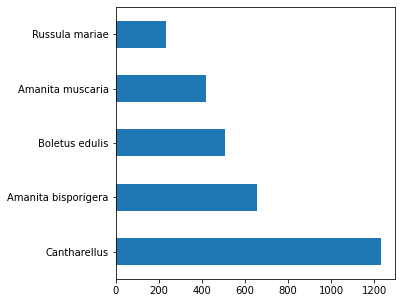

In [19]:
labels_csv["Species"].value_counts().plot.barh(figsize=(5,5))


In [20]:
labels_csv["Species"].value_counts().mean()

609.4

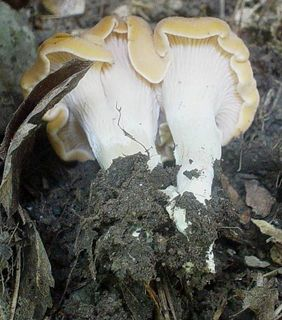

In [21]:
from IPython.display import Image
Image("basedata3/Cantharellus/101349.jpg")

In [22]:

file_names = file_path + labels_csv["Species"] + "/" + labels_csv["Name"]
file_names.head()
file_names[2880]

'/content/basedata3/Amanita muscaria/Amanita_muscaria69.png'

In [23]:
filenames= [ fname for fname in file_names]
filenames[:10]

['/content/basedata3/Amanita bisporigera/100598.jpg',
 '/content/basedata3/Amanita bisporigera/100599.jpg',
 '/content/basedata3/Amanita bisporigera/100600.jpg',
 '/content/basedata3/Amanita bisporigera/100626.jpg',
 '/content/basedata3/Amanita bisporigera/100628.jpg',
 '/content/basedata3/Amanita bisporigera/100629.jpg',
 '/content/basedata3/Amanita bisporigera/100630.jpg',
 '/content/basedata3/Amanita bisporigera/100631.jpg',
 '/content/basedata3/Amanita bisporigera/101388.jpg',
 '/content/basedata3/Amanita bisporigera/101389.jpg']

In [24]:
import numpy as np
labels = labels_csv["Species"].to_numpy()
#labels = np.array(labels)
labels

array(['Amanita bisporigera', 'Amanita bisporigera',
       'Amanita bisporigera', ..., 'Boletus edulis', 'Boletus edulis',
       'Boletus edulis'], dtype=object)

In [25]:
#Find unique label values
unique_species = np.unique(labels)
len(unique_species)

5

In [26]:
#Turn every label into a boolean array
boolean_labels = [label == np.array(unique_species) for label in labels]
boolean_labels[:2]

[array([ True, False, False, False, False]),
 array([ True, False, False, False, False])]

# Creating a validation set
Num_Images determines how many images our initial model will be trained on. This is to determine initial accuracy and loss, so that we can compare once we have trained a model on the full dataset.

In [27]:
#SEtup up X & y variables
X = filenames 
y=boolean_labels

In [28]:
#There are 3139 images. 
#Set number of images to use for experimenting.
#Will start with 1000
NUM_IMAGES = 2000 #@param{type:"slider", min:1000, max:3139}

In [29]:
#Let's split our data into train and validation sets
from sklearn.model_selection import train_test_split

#Split into training and validation of total size NUM_IMAGES
X_train, X_val, y_train, y_val=train_test_split(X[:NUM_IMAGES],
                                                y[:NUM_IMAGES],
                                                test_size=.4,
                                                random_state=42)

len(X_train),len(y_train),len(X_val),len(y_val)

(1200, 1200, 800, 800)

In [30]:
from matplotlib.pyplot import imread
image = imread(filenames[30])
image.shape

(240, 320, 3)

# Preprocessing data

In [31]:
IMG_SIZE = 224


def process_image(image_path, img_size=IMG_SIZE):
  #read an imafe file
  image = tf.io.read_file(image_path)
  #Turn jpg image into a tensor with 3 channels
  image=tf.image.decode_jpeg(image, channels=3)
  #Convert the color channel values from 0-255 to 0-1values
  image=tf.image.convert_image_dtype(image,tf.float32)
  #Resize the image to a specific value
  image= tf.image.resize(image, size=[IMG_SIZE,IMG_SIZE])
  return image

## Turning our data into batches


In [32]:
#Create a simple function to return a tuple
def get_image_label(image_path, label):
  image = process_image(image_path)
  return image,label

In [33]:
#Defining batch size
BATCH_SIZE=32

# create a function to turn data into batches
def create_data_batches(x,y=None,batch_size=BATCH_SIZE,valid_data=False,test_data=False):
  # If the data is a test dataset, probably no labels.
  if test_data:
    print("Creating test data batches")
    data=tf.data.Dataset.from_tensor_slices((tf.constant(x)))
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  # Else if the data is a valid dataset, no ndea to shuffle.
  elif valid_data:
    print("Creating Validation Data batches")
    data=tf.data.Dataset.from_tensor_slices((tf.constant(x),#filepaths
                                             tf.constant(y)))# labels
    data_batch=data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch
  
  else:
    print("creating training data batchs")
    #Turn filepaths and labels into tensors
    data=tf.data.Dataset.from_tensor_slices((tf.constant(x),
                                             tf.constant(y)))
    #shuffling pathnames and labels before mapping image process
    data = data.shuffle(buffer_size=len(x))

    #create(image,label) tuples (turns image path into preprocessed image)
    data=data.map(get_image_label)

    #Turn training data into batches
    data_batch = data.batch(BATCH_SIZE)
  return data_batch

In [34]:
#create trainig and validation data batchs
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

creating training data batchs
Creating Validation Data batches


In [35]:
#Check different attributes of data batches
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 5), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 5), dtype=tf.bool, name=None)))

## Visualizing our data batches

In [36]:
import matplotlib.pyplot as plt

#create function for viewing images in a data batch
def show_25_images(images,labels):
  ##Displays plot of 25 images and their labels in a batch
  plt.figure(figsize=(10,10))
  for i in range(25):
    #create subplots
    ax = plt.subplot(5,5,i+1)
    #Display an image
    plt.imshow(images[i])
    #Add image label
    plt.title(unique_species[labels[i].argmax()])
    plt.axis("off")
    

In [37]:
train_images, train_labels = next(train_data.as_numpy_iterator())

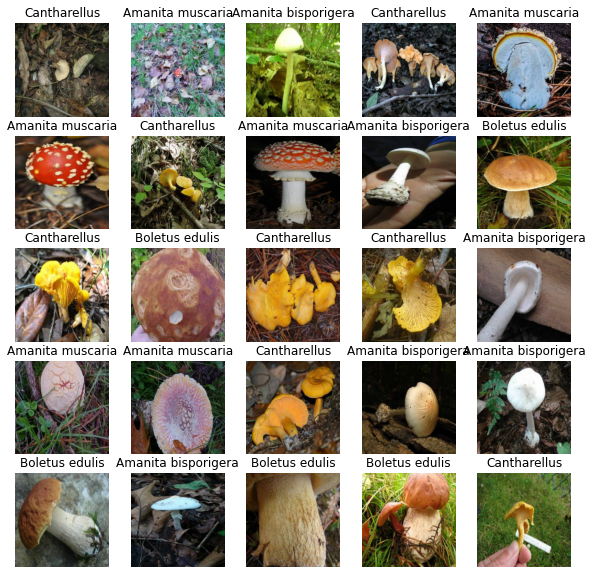

In [38]:
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images,train_labels)

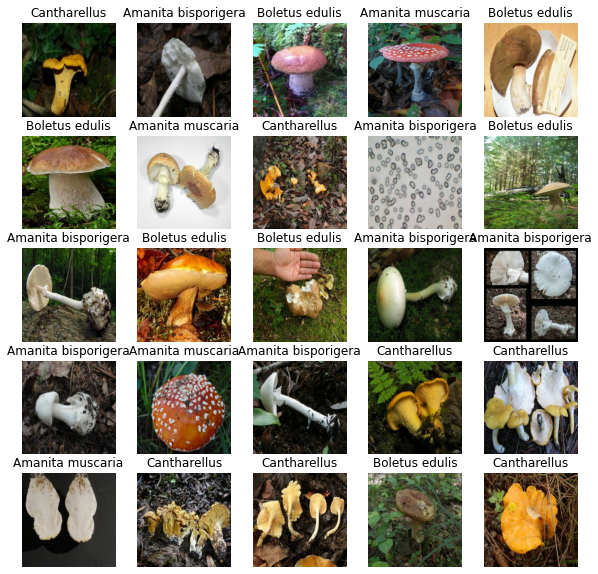

In [39]:
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

# Importing MobileNetv3 

## Creating the model structure and display summary of the structure

Inceptionv3 tensorflow hub = https://tfhub.dev/google/tf2-preview/inception_v3/classification/4

EfficientNetv2 = https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_b0/classification/2

MobileNet = https://tfhub.dev/google/imagenet/mobilenet_v3_small_100_224/classification/5

resnet50 = https://tfhub.dev/tensorflow/resnet_50/classification/1

In [40]:
INPUT_SHAPE=[None, IMG_SIZE, IMG_SIZE,3]
OUTPUT_SHAPE=len(unique_species)
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v3_small_100_224/classification/5"

In [41]:
def create_model(input_shape=INPUT_SHAPE,output_shape = OUTPUT_SHAPE,model_url=MODEL_URL):
  print("BUilding model with: ", MODEL_URL)
  model = tf.keras.Sequential([
                               hub.KerasLayer(MODEL_URL),
                               tf.keras.layers.Dense(units=len(unique_species),
                                                     activation = "softmax")])
  model.compile(
    loss = 'categorical_crossentropy',
    optimizer = 'adam',
    metrics = ['accuracy']
                )
  model.build(INPUT_SHAPE)
  return model

In [42]:
#creating a model object
model = create_model()

BUilding model with:  https://tfhub.dev/google/imagenet/mobilenet_v3_small_100_224/classification/5


In [43]:
#View the structure of the model
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              2555993   
                                                                 
 dense (Dense)               (None, 5)                 5010      
                                                                 
Total params: 2,561,003
Trainable params: 5,010
Non-trainable params: 2,555,993
_________________________________________________________________


# Tensorboard Setup

## Creating callbacks
### Load TensorBoard notebook extension
To setup a tensorboard callback, need to do 3 things. 
Load tensorboard extension
create a tensorboard callback which is able to save logs to a directory and pass it to our models fit function
visualize the training logs with tensorboard.

In [44]:
%load_ext tensorboard

## Early stopping Callback
Stops the model from overfitting by stopping training if a certain metric stops improving.

In [45]:
#create early stopping calback
def create_tensorboard_callback():
  #Create a log directory for storing longs for tensorboard
  logdir = os.path.join("logs",
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  histogram_freq=1,
  return tf.keras.callbacks.TensorBoard(logdir)


early_stopping=tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",patience=4)

# Checking whether a gpu is being used.



In [46]:
print("GPU", "available(YES)" if tf.config.list_physical_devices("GPU") else"not available")

GPU available(YES)


# Fitting the model

In [47]:
NUM_EPOCHS = 100 #@param {type:"slider",min:1,max:25,step:1}

In [48]:
tensorboard=create_tensorboard_callback()
r = model.fit(x=train_data,
          epochs=NUM_EPOCHS,
          validation_data=val_data,
          validation_freq=1,
          callbacks=[tensorboard,early_stopping
                     ]
          )

Epoch 1/100
38/38 [==============================] - 17s 88ms/step - loss: 1.0409 - accuracy: 0.6267 - val_loss: 0.4919 - val_accuracy: 0.8313
Epoch 2/100
38/38 [==============================] - 3s 80ms/step - loss: 0.3314 - accuracy: 0.8825 - val_loss: 0.3761 - val_accuracy: 0.8700
Epoch 3/100
38/38 [==============================] - 3s 72ms/step - loss: 0.2107 - accuracy: 0.9383 - val_loss: 0.3529 - val_accuracy: 0.8838
Epoch 4/100
38/38 [==============================] - 3s 72ms/step - loss: 0.1601 - accuracy: 0.9525 - val_loss: 0.3425 - val_accuracy: 0.8875
Epoch 5/100
38/38 [==============================] - 3s 74ms/step - loss: 0.1269 - accuracy: 0.9675 - val_loss: 0.3382 - val_accuracy: 0.8925
Epoch 6/100
38/38 [==============================] - 3s 73ms/step - loss: 0.1012 - accuracy: 0.9833 - val_loss: 0.3380 - val_accuracy: 0.8913
Epoch 7/100
38/38 [==============================] - 3s 80ms/step - loss: 0.0848 - accuracy: 0.9858 - val_loss: 0.3371 - val_accuracy: 0.8925
Epoch

## Checking the predictions of model 1

In [49]:
predictions = model.predict(val_data, verbose=1)
predictions

25/25 [==============================] - 2s 42ms/step


array([[7.06122140e-04, 2.41776253e-03, 2.84788606e-04, 9.96581852e-01,
        9.53188919e-06],
       [9.98002827e-01, 2.15863387e-04, 1.52405755e-05, 1.76568597e-03,
        4.22247325e-07],
       [1.55448103e-02, 4.27518874e-01, 5.56067228e-01, 8.16156564e-04,
        5.29631252e-05],
       ...,
       [1.29617183e-04, 6.03284047e-04, 9.14768755e-01, 8.44942108e-02,
        4.10392522e-06],
       [2.06904896e-02, 9.97531242e-05, 9.78987694e-01, 2.19885813e-04,
        2.22330959e-06],
       [9.94330287e-01, 1.80555566e-03, 3.78916808e-03, 6.03182634e-05,
        1.46454058e-05]], dtype=float32)

In [50]:
def get_pred_label(prediction_probabilities):
  return unique_species[np.argmax(prediction_probabilities)]


In [51]:

pred_label=get_pred_label(predictions[0])
pred_label

'Cantharellus'

# Unbatching validation data

In [52]:
#create a function to unbatch a batch dataset
def unbatchify(data):
  #takes a batch dataset of tensors and returns seperate arrays of images,labels
  images = []
  labels = []
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_species[np.argmax(label)])
  return images, labels

val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.03613446, 0.02044818, 0.02436975],
         [0.03669468, 0.02857143, 0.02492997],
         [0.02689076, 0.02745098, 0.01932773],
         ...,
         [0.08739468, 0.09495778, 0.04369734],
         [0.06610634, 0.07535006, 0.03781511],
         [0.04173644, 0.05350115, 0.02605017]],
 
        [[0.03613446, 0.02044818, 0.02436975],
         [0.03669468, 0.02857143, 0.02492997],
         [0.02689076, 0.02745098, 0.01932773],
         ...,
         [0.07606028, 0.08388092, 0.03931828],
         [0.06043914, 0.07200126, 0.03910314],
         [0.04250917, 0.0599413 , 0.03249032]],
 
        [[0.03613446, 0.02044818, 0.01757703],
         [0.03451131, 0.02638806, 0.02032063],
         [0.02689076, 0.02745098, 0.01884254],
         ...,
         [0.05784557, 0.0693276 , 0.02510767],
         [0.04878451, 0.06952529, 0.03484897],
         [0.0437899 , 0.06850996, 0.03839033]],
 
        ...,
 
        [[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.     

# Visualizing model predictions


In [53]:
#imports
import matplotlib.pyplot as plt

In [54]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  pred_prob,true_label, image=prediction_probabilities[n], labels[n], images[n]
  pred_label = get_pred_label(pred_prob)
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  #Change the color of the title 
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% {}".format(pred_label, 
                                    np.max(pred_prob)*100,
                                    true_label),
            color = color
  )
  

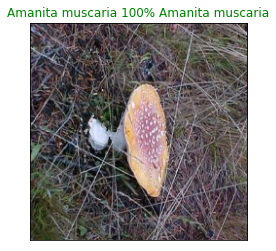

In [55]:
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images,
          n=45
          )

###View our models Top 10 predictions
Take an input of prediction probabilities array, and grount truth array and an int.
Find prediction using get_pred_label()
Find top 10 Pred prob index, values and labels.

In [56]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  pred_prob, true_label = prediction_probabilities[n], labels[n]
  pred_label=get_pred_label(pred_prob)
  #confidence index
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  #confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  #pred labels
  top_10_pred_labels= unique_species[top_10_pred_indexes]
  #setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                               top_10_pred_values,
                               color="grey"
  )
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")
  
  #change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass


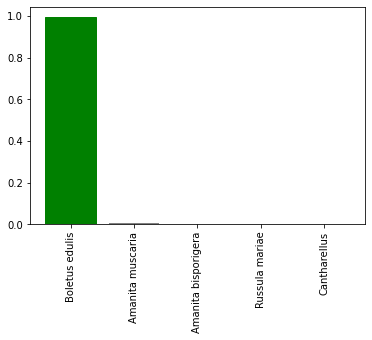

In [57]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=5)

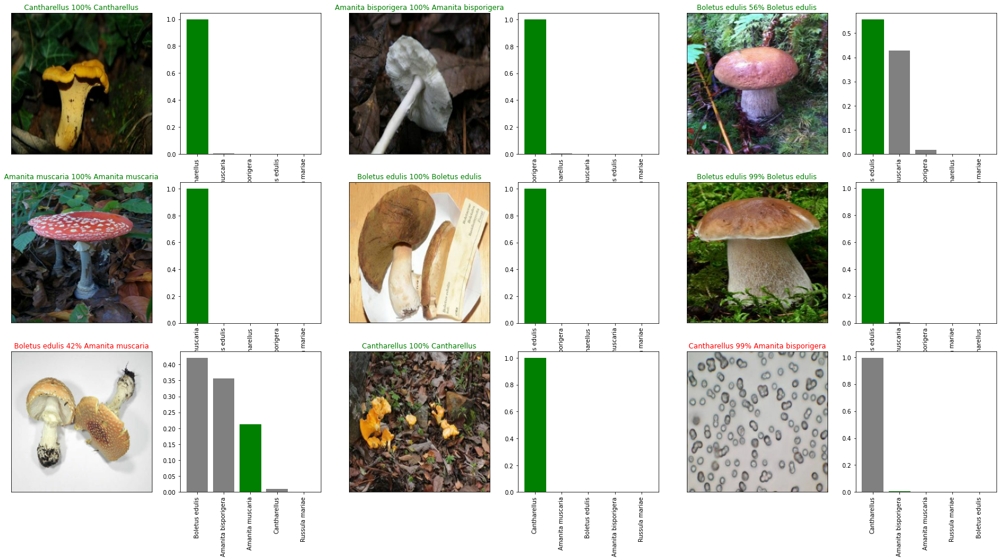

In [58]:
i_multiplier = 0
num_rows=3
num_cols=3
num_images=num_rows*num_cols
plt.figure(figsize=(10*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot (num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                 labels=val_labels,
                 n=i+i_multiplier)
plt.show()

In [59]:
acc = model.evaluate(val_data,steps=len(val_data),verbose=2)
print('%.2f'%(acc[1]*100))

25/25 - 1s - loss: 0.3356 - accuracy: 0.8925 - 1s/epoch - 49ms/step
89.25


#Saving and loading the model.

## Saving the model


In [60]:
saved_model = save_model(model, suffix="partial_model")

Saving model to: /content/20220708-23201657322423-partial_model.h5


## Loading a model

In [61]:
loaded_1000_model = load_model(saved_model)

loading model from: /content/20220708-23201657322423-partial_model.h5


In [62]:
#evaluate the presaved model
model.evaluate(val_data)

25/25 [==============================] - 1s 46ms/step - loss: 0.3356 - accuracy: 0.8925


[0.3356485068798065, 0.8924999833106995]

In [63]:
loaded_1000_model.evaluate(val_data)

25/25 [==============================] - 2s 47ms/step - loss: 0.3356 - accuracy: 0.8925


[0.3356485068798065, 0.8924999833106995]

# Training a  model on full data.

In [64]:
full_data = create_data_batches(X,y)

creating training data batchs


In [65]:
full_model = create_model()
full_model.summary()

BUilding model with:  https://tfhub.dev/google/imagenet/mobilenet_v3_small_100_224/classification/5
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_1 (KerasLayer)  (None, 1001)              2555993   
                                                                 
 dense_1 (Dense)             (None, 5)                 5010      
                                                                 
Total params: 2,561,003
Trainable params: 5,010
Non-trainable params: 2,555,993
_________________________________________________________________


In [66]:
full_model_tensorboard = create_tensorboard_callback()
full_model_early_callback = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience = 3)

In [67]:
r2 = full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard,
                          full_model_early_callback])

Epoch 1/100
96/96 [==============================] - 9s 46ms/step - loss: 0.6910 - accuracy: 0.7667
Epoch 2/100
96/96 [==============================] - 4s 45ms/step - loss: 0.2782 - accuracy: 0.9147
Epoch 3/100
96/96 [==============================] - 4s 45ms/step - loss: 0.2102 - accuracy: 0.9294
Epoch 4/100
96/96 [==============================] - 4s 44ms/step - loss: 0.1716 - accuracy: 0.9442
Epoch 5/100
96/96 [==============================] - 4s 45ms/step - loss: 0.1398 - accuracy: 0.9570
Epoch 6/100
96/96 [==============================] - 4s 45ms/step - loss: 0.1200 - accuracy: 0.9632
Epoch 7/100
96/96 [==============================] - 4s 45ms/step - loss: 0.1039 - accuracy: 0.9728
Epoch 8/100
96/96 [==============================] - 4s 45ms/step - loss: 0.0902 - accuracy: 0.9790
Epoch 9/100
96/96 [==============================] - 4s 44ms/step - loss: 0.0819 - accuracy: 0.9797
Epoch 10/100
96/96 [==============================] - 4s 44ms/step - loss: 0.0753 - accuracy: 0.9846

### Checking tensorboard logs

In [68]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

##Saving and loading full model

### Saving model trained on full dataset

In [69]:
loaded_full_data_model = save_model(full_model,suffix="full_model")

Saving model to: /content/20220708-23221657322574-full_model.h5


### Loading model trained on full dataset

In [70]:
loaded_full_model = load_model(loaded_full_data_model)

loading model from: /content/20220708-23221657322574-full_model.h5


# Making Predictions on test dataset

In [71]:
test_path = "/content/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]
print(test_filenames[:10])
print(len(test_filenames))

['/content/test/am7.jpg', '/content/test/be (2).jpg', '/content/test/am (4).jpg', '/content/test/rm234.jpg', '/content/test/ab2.jpg', '/content/test/be (1).jpg', '/content/test/am (3).jpg', '/content/test/boletus-edulis7.jpg', '/content/test/russula mariae.jpg', '/content/test/rm.jpg']
34


In [72]:
test_data = create_data_batches(test_filenames, test_data=True)

Creating test data batches


In [73]:
test_predictions = loaded_full_model.predict(test_data,verbose=1)

2/2 [==============================] - 1s 154ms/step


In [74]:
np.savetxt("/content/test_predictions.csv", test_predictions, delimiter=',')

In [75]:
test_predictions=np.loadtxt("/content/test_predictions.csv",delimiter=',')

In [76]:
test_predictions.shape

(34, 5)

In [77]:
test_pred_labels = [get_pred_label(test_predictions[i]) for i in range(len(test_predictions))]
test_pred_labels

['Amanita bisporigera',
 'Boletus edulis',
 'Amanita muscaria',
 'Russula mariae',
 'Amanita bisporigera',
 'Boletus edulis',
 'Amanita muscaria',
 'Boletus edulis',
 'Boletus edulis',
 'Russula mariae',
 'Amanita bisporigera',
 'Cantharellus',
 'Cantharellus',
 'Amanita bisporigera',
 'Amanita bisporigera',
 'Cantharellus',
 'Russula mariae',
 'Boletus edulis',
 'Amanita muscaria',
 'Amanita bisporigera',
 'Boletus edulis',
 'Cantharellus',
 'Boletus edulis',
 'Russula mariae',
 'Amanita bisporigera',
 'Cantharellus',
 'Amanita muscaria',
 'Russula mariae',
 'Amanita muscaria',
 'Amanita muscaria',
 'Cantharellus',
 'Russula mariae',
 'Amanita bisporigera',
 'Russula mariae']

In [78]:
#Get Test images
custom_images = []
#loop thru unbatched data
for image in test_data.unbatch().as_numpy_iterator():
  custom_images.append(image)


## Checking Predictions

In [79]:
import ipywidgets as widgets
from ipywidgets import interact, interact_manual
from IPython.display import Image

In [80]:
fdir = '/content/test/'
@interact 
def show_test_images(file=os.listdir('/content/test/')):
  display(Image(fdir+file))

interactive(children=(Dropdown(description='file', options=('am7.jpg', 'be (2).jpg', 'am (4).jpg', 'rm234.jpg'…

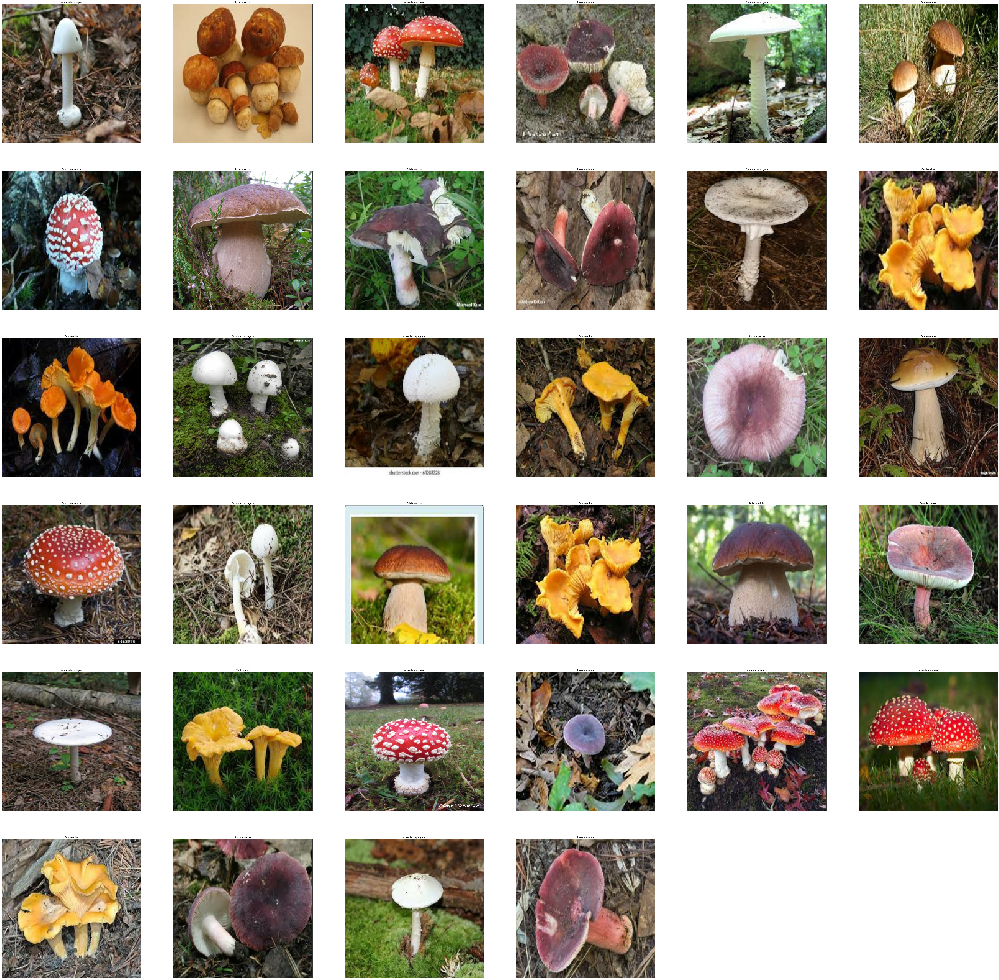

In [81]:

#Check custom image predictions
plt.figure(figsize=(100,100))
for i, image in enumerate(custom_images):
  plt.subplot(6,6,i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(test_pred_labels[i], fontsize=12)
  plt.imshow(image)

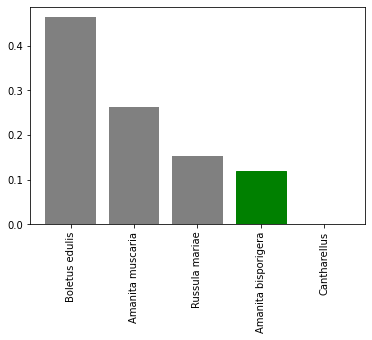

In [82]:
plot_pred_conf(prediction_probabilities=test_predictions,
               labels=val_labels,
               n=8)

In [83]:
print(test_predictions[0])
print(f"Max Value(probability of prediction:{np.max(test_predictions[0])}")
print(f"Sum: {np.sum(test_predictions[0])}")
print(f"Max index: {np.argmax(test_predictions[0])}")
print(f"Predicted labal:{unique_species[np.argmax(test_predictions[0])]}")

[9.99997735e-01 1.14519912e-06 5.20660448e-09 8.33568947e-07
 2.73233979e-07]
Max Value(probability of prediction:0.9999977350234985
Sum: 0.999999992232151
Max index: 0
Predicted labal:Amanita bisporigera


In [84]:
test_predictions[0]

array([9.99997735e-01, 1.14519912e-06, 5.20660448e-09, 8.33568947e-07,
       2.73233979e-07])

In [85]:
acc = model.evaluate(test_data,steps=len(test_data),verbose=2)
print('%.2f'%(acc[1]*100))

2/2 - 0s - loss: 0.0000e+00 - accuracy: 0.0000e+00 - 448ms/epoch - 224ms/step
0.00


In [86]:
acc2 = full_model.evaluate(test_data,steps=len(test_data),verbose=2)
print('%.2f'%(acc2[1]*100))

2/2 - 0s - loss: 0.0000e+00 - accuracy: 0.0000e+00 - 450ms/epoch - 225ms/step
0.00


# Plotting Metics of Models trained on partial and full dataset.

##Partial Model Graphs

### Plotting Loss on model trained on partial dataset

#### Plotting accuracy on model trained on partial dataset

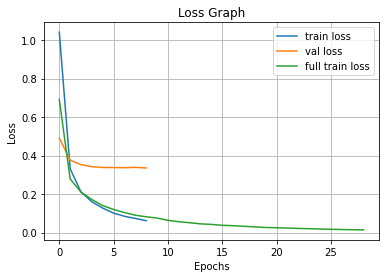

In [87]:
plt.plot(r.history['loss'], label='train loss')
plt.plot(r.history['val_loss'], label='val loss')
plt.plot(r2.history['loss'], label='full train loss')
plt.grid(True)
plt.title("Loss Graph")
plt.ylabel("Loss")
plt.xlabel("Epochs")
plt.legend()
plt.savefig(datetime.datetime.now().strftime("%Y%m%d-%H%M%S")+'_'+'2_Model_Loss.png',dpi=100, facecolor='w')
plt.show()


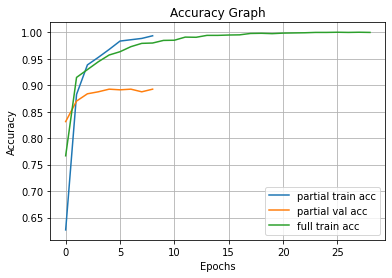

In [88]:
plt.plot(r.history['accuracy'], label='partial train acc')
plt.plot(r.history['val_accuracy'], label='partial val acc')
plt.plot(r2.history['accuracy'], label='full train acc')
plt.grid(True)
plt.title("Accuracy Graph")
plt.ylabel("Accuracy")
plt.xlabel("Epochs")
plt.legend()
plt.draw()
plt.savefig(datetime.datetime.now().strftime("%Y%m%d-%H%M%S")+'_'+'2_Model_accuracy',dpi=100,facecolor='w')
plt.show()

## Plotting Accuracy InceptionV3

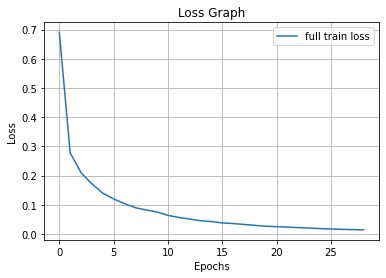

In [89]:
plt.plot(r2.history['loss'], label='full train loss')
plt.grid(True)
plt.title("Loss Graph")
plt.ylabel("Loss")
plt.xlabel("Epochs")
plt.legend()
plt.savefig(datetime.datetime.now().strftime("%Y%m%d-%H%M%S")+'_'+'Full_Model_Loss.png',dpi=100, facecolor='w')
plt.show()


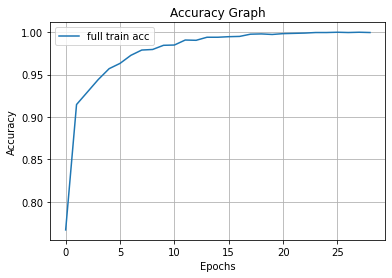

In [90]:
plt.plot(r2.history['accuracy'], label='full train acc')
plt.grid(True)
plt.title("Accuracy Graph")
plt.ylabel("Accuracy")
plt.xlabel("Epochs")
plt.legend()
plt.draw()
plt.savefig(datetime.datetime.now().strftime("%Y%m%d-%H%M%S")+'_'+'Full_Model_Accuracy',dpi=100,facecolor='w')
plt.show()

# Solving "PIL.UnidentifiedImageError: cannot identify image file <_io.BytesIO object at 0x7f13b3e01c50>"

There seems to be an issue regarding an image. The following code will read thru the specified folders and print out the image that is causing issues. 

1 image was found in Cantharellus, '587054' and was promptly deleted.
After deletion, make sure to rerun runtime.

### Switched to text to avoid running this code again.

import PIL
from pathlib import Path
from PIL import UnidentifiedImageError

path = Path("/content/drive/MyDrive/MushVision/basedata/testing").rglob("*.jpg")
for img_p in path:
    try:
        img = PIL.Image.open(img_p)
    except PIL.UnidentifiedImageError:
            print(img_p)

import PIL
from pathlib import Path
from PIL import UnidentifiedImageError

path = Path("/content/drive/MyDrive/MushVision/basedata/training").rglob("*.jpg")
for img_p in path:
    try:
        img = PIL.Image.open(img_p)
    except PIL.UnidentifiedImageError:
            print(img_p)